In [1]:
import sys,os
__script_path=os.path.abspath(globals().get('__file__','.'))
__script_dir = os.path.dirname(__script_path)
root_dir = os.path.abspath(f'{__script_dir}/../')
print(root_dir)
for lib in [root_dir][::-1]:
    if lib in sys.path:
        sys.path.remove(lib)
    sys.path.insert(0,lib)



e:\User\PC\ads_enefit_ueh\ads_enfit


In [2]:
from libs.common import *
from config.config import *
from models.models import VGG16

IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html


e:/User/PC/ads_enefit_ueh/ads_enfit


In [3]:
if os.path.exists(exps_dir) == False: # tạo thư mục (nếu chưa có)
  os.makedirs(exps_dir, exist_ok=True)

save_dir = f"{exps_dir}/exp2"
os.makedirs(save_dir, exist_ok=True)

In [4]:
plt.style.use(f'{style_dir}/style.mplstyle')
shap.initjs()

In [5]:
ndays=1
X=pd.read_csv(f'{save_dir}/X.csv', index_col=None)
y=pd.read_csv(f'{save_dir}/y.csv', index_col=None)
X_train=pd.read_csv(f'{save_dir}/X_train.csv', index_col=None)
X_valid=pd.read_csv(f'{save_dir}/X_valid.csv', index_col=None)
y_train=pd.read_csv(f'{save_dir}/y_train.csv', index_col=None)
y_valid=pd.read_csv(f'{save_dir}/y_valid.csv', index_col=None)
X_test=pd.read_csv(f'{save_dir}/X_test.csv', index_col=None)
y_test=pd.read_csv(f'{save_dir}/y_test.csv', index_col=None)

best_params = dict(np.load(f'{save_dir}/best_params_.npz',allow_pickle=True))


In [6]:
X.drop(columns=['Unnamed: 0'], inplace=True)
y.drop(columns=['Unnamed: 0'], inplace=True)
X_train.drop(columns=['Unnamed: 0'], inplace=True)
X_valid.drop(columns=['Unnamed: 0'], inplace=True)
y_train.drop(columns=['Unnamed: 0'], inplace=True)
y_valid.drop(columns=['Unnamed: 0'], inplace=True)
X_test.drop(columns=['Unnamed: 0'], inplace=True)
y_test.drop(columns=['Unnamed: 0'], inplace=True)
print(X_train.shape, y_train.shape, X_valid.shape, y_valid.shape, X_test.shape, y_test.shape)

(1079454, 141) (1079454, 1) (531672, 141) (531672, 1) (6144, 141) (6144, 1)


### Analyze the regression relation

#### Use OLS regression

In [7]:
def analyze_OLS(x,y):
    x = sm.add_constant(x)  
    model = sm.OLS(y, x,hasconst=True)
    results = model.fit()
    summary = results.summary()
    # print(summary)
    return summary
print(analyze_OLS(X,y))

                            OLS Regression Results                            
Dep. Variable:                 target   R-squared:                       0.951
Model:                            OLS   Adj. R-squared:                  0.951
Method:                 Least Squares   F-statistic:                 2.244e+05
Date:                Tue, 23 Jul 2024   Prob (F-statistic):               0.00
Time:                        20:51:08   Log-Likelihood:            -1.0884e+07
No. Observations:             1611126   AIC:                         2.177e+07
Df Residuals:                 1610986   BIC:                         2.177e+07
Df Model:                         139                                         
Covariance Type:            nonrobust                                         
                                              coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------------

#### Use Linear machine learning model

In [8]:
def print_sorted_coefficients(model, model_name, feature_names):
    coef = model.coef_
    if len(coef.shape) > 1:
        coef = coef[0]
    sorted_indices = np.argsort(-np.abs(coef))  
    sorted_coef = coef[sorted_indices]
    sorted_feature_names = [feature_names[i] for i in sorted_indices]
    for i, (name, value) in enumerate(zip(sorted_feature_names, sorted_coef)):
        print(f"{model_name} Coefficient {i + 1}: {name}, Coefficient: {value}")

In [9]:
linear_model = LinearRegression()
linear_model.fit(X_train, y_train)
y_pred_linear = linear_model.predict(X_valid)

print_sorted_coefficients(linear_model, "Linear Regression", X_train.columns)
print("Linear Regression intercept:", linear_model.intercept_)





Linear Regression Coefficient 1: diffuse_radiation_hl_2d, Coefficient: 145460.57636985063
Linear Regression Coefficient 2: shortwave_radiation_hl_2d, Coefficient: -145460.5356294382
Linear Regression Coefficient 3: direct_solar_radiation_hl_2d, Coefficient: 145460.52879661068
Linear Regression Coefficient 4: direct_solar_radiation_hl_7d, Coefficient: -51489.94995077478
Linear Regression Coefficient 5: shortwave_radiation_hl_7d, Coefficient: 51489.88811652166
Linear Regression Coefficient 6: diffuse_radiation_hl_7d, Coefficient: -51489.88573993439
Linear Regression Coefficient 7: total_precipitation_fd_7d, Coefficient: -21704.863326534203
Linear Regression Coefficient 8: target_mean, Coefficient: -19402.973161056867
Linear Regression Coefficient 9: snowfall, Coefficient: 11295.778225026312
Linear Regression Coefficient 10: diffuse_radiation, Coefficient: -11013.074001679439
Linear Regression Coefficient 11: direct_solar_radiation_hd_2d, Coefficient: -11012.918362078164
Linear Regression

In [10]:
print("Linear Regression R²:", r2_score(y_valid, y_pred_linear))
print("Linear Regression MAE:", mean_absolute_error(y_valid, y_pred_linear))

Linear Regression R²: 0.9375564641674334
Linear Regression MAE: 129.6638586617819


In [11]:
y_pred_linear = linear_model.predict(X_test)
print("Linear Regression R²:", r2_score(y_test, y_pred_linear))
print("Linear Regression MAE:", mean_absolute_error(y_test, y_pred_linear))

Linear Regression R²: 0.9087076348467182
Linear Regression MAE: 147.1732020665263


In [12]:
ridge_model = Ridge(alpha=1.0)
ridge_model.fit(X_train, y_train)
y_pred_ridge = ridge_model.predict(X_valid)

In [13]:

print_sorted_coefficients(ridge_model, "Ridge Regression", X_train.columns)
print("Ridge Regression intercept:", ridge_model.intercept_)


Ridge Regression Coefficient 1: total_precipitation_fl_7d, Coefficient: -161.4039173971343
Ridge Regression Coefficient 2: total_precipitation_fd_7d, Coefficient: -118.16362762872429
Ridge Regression Coefficient 3: total_precipitation_fl, Coefficient: 92.56033865720616
Ridge Regression Coefficient 4: snowfall_fl, Coefficient: 63.29416869258458
Ridge Regression Coefficient 5: target_mean, Coefficient: -40.88495623430556
Ridge Regression Coefficient 6: snowfall, Coefficient: 38.351628841410474
Ridge Regression Coefficient 7: snowfall_hd_2d, Coefficient: 30.689431644253617
Ridge Regression Coefficient 8: rain_hd_7d, Coefficient: -26.003471031646992
Ridge Regression Coefficient 9: sin(dayofyear), Coefficient: -20.339196612239583
Ridge Regression Coefficient 10: rain, Coefficient: -16.247361421809234
Ridge Regression Coefficient 11: snowfall_hd_7d, Coefficient: 9.514115996007028
Ridge Regression Coefficient 12: snowfall_fd_7d, Coefficient: -7.910080436316993
Ridge Regression Coefficient 13:

In [14]:
print("Linear Regression R²:", r2_score(y_valid, y_pred_ridge))
print("Linear Regression MAE:", mean_absolute_error(y_valid, y_pred_ridge))

Linear Regression R²: 0.9455222538458318
Linear Regression MAE: 80.41148120381276


In [15]:
y_pred_ridge = ridge_model.predict(X_test)
print("Linear Regression R²:", r2_score(y_test, y_pred_ridge))
print("Linear Regression MAE:", mean_absolute_error(y_test, y_pred_ridge))

Linear Regression R²: 0.9190326537145256
Linear Regression MAE: 94.35306006849085


### Build LGBM and Improve in valid set

In [16]:

# lgbm_model = lgb.LGBMRegressor(objective='regression',**best_params['lgb_grid_search'].item())
# lgbm_model.fit(X_train, y_train)
# dump(lgbm_model, f'{save_dir}/lgbm_model_tuning.joblib')
lgbm_model=joblib.load(f'{save_dir}/lgbm_model_tuning.joblib')





In [17]:
lgbm_model_predictions = lgbm_model.predict(X_valid)
lgbm_model_mae = mean_absolute_error(y_valid, lgbm_model_predictions)
lgbm_model_r2 = r2_score(y_valid, lgbm_model_predictions)
print(f"LGBM model - Validation MAE: {lgbm_model_mae:.3f}, Validation R2: {lgbm_model_r2:.3f}")

LGBM model - Validation MAE: 58.483, Validation R2: 0.958


In [18]:
lgbm_model_predictions = lgbm_model.predict(X_test)
lgbm_model_mae = mean_absolute_error(y_test, lgbm_model_predictions)
lgbm_model_r2 = r2_score(y_test, lgbm_model_predictions)
print(f"LGBM model - Test MAE: {lgbm_model_mae:.3f}, Test R2: {lgbm_model_r2:.3f}")

LGBM model - Test MAE: 85.757, Test R2: 0.911


### Use LIME, SHAP to explained

 92%|==================  | 5682/6144 [00:15<00:01]       

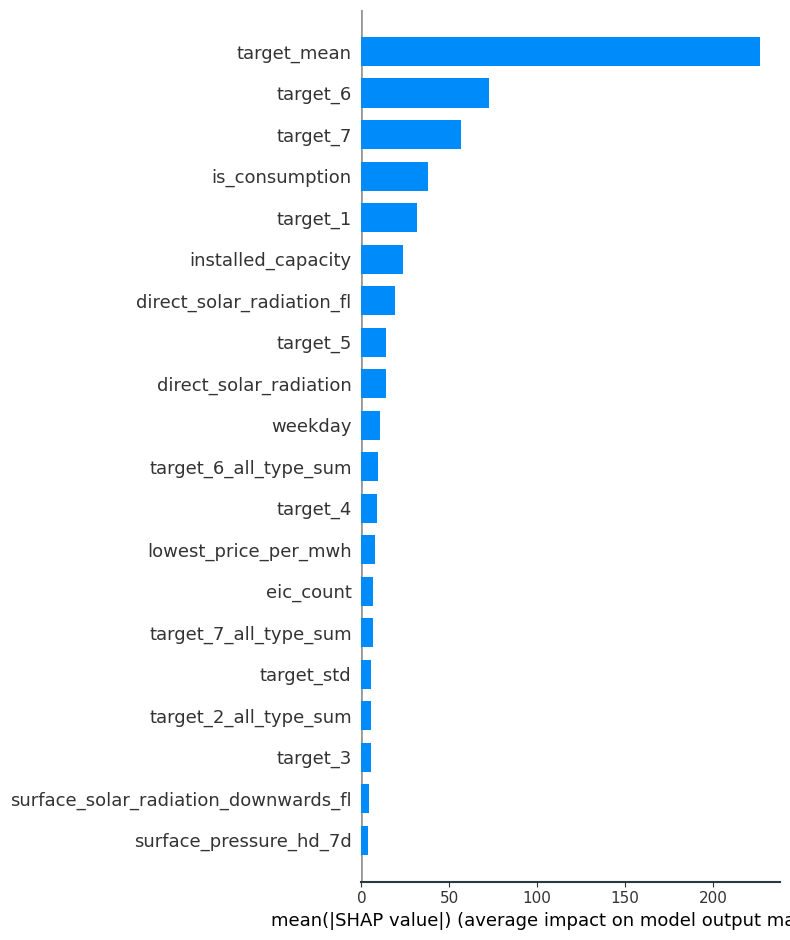

In [20]:
explainer_lgbm = shap.Explainer(lgbm_model, X_train)
shap_values_lgbm = explainer_lgbm(X_test, check_additivity=False)


shap.summary_plot(shap_values_lgbm, X_test, plot_type="bar", title="SHAP LGBM Feature Importance")


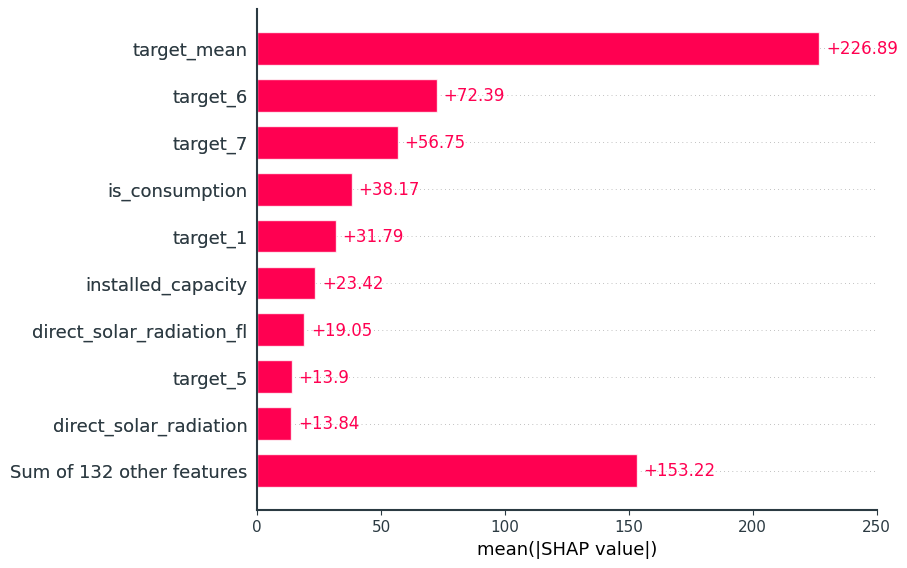

In [21]:
shap.plots.bar(shap_values_lgbm, show=False)
plt.show()
# plt.savefig("plots/bar.png")

In [22]:
i_med = np.argsort(lgbm_model_predictions)[len(lgbm_model_predictions)//2]
i_max = np.argmax(lgbm_model_predictions)
i_80 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.8)]
i_60 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.6)]
i_40 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.4)]
i_20 = np.argsort(lgbm_model_predictions)[int(len(lgbm_model_predictions)*0.2)]
i_min = np.argmin(lgbm_model_predictions)


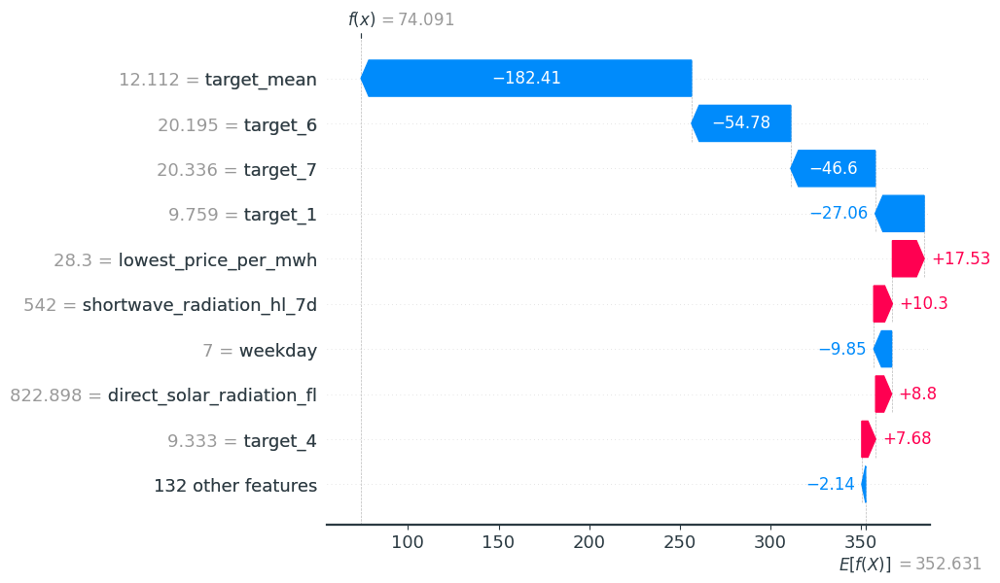

In [23]:
shap.plots.waterfall(shap_values_lgbm[i_med],show=True)
plt.show()
# plt.savefig("plots/waterfall_median.png")

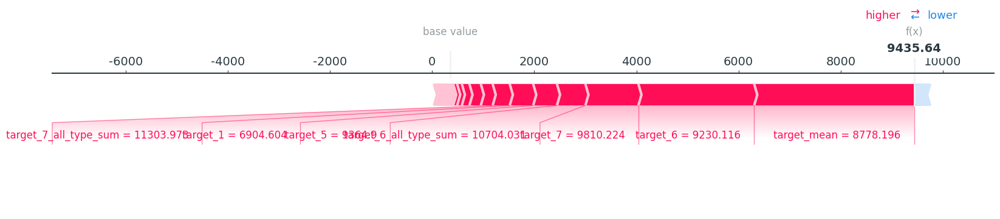

In [24]:
shap.plots.force(shap_values_lgbm[i_max], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_max.png")

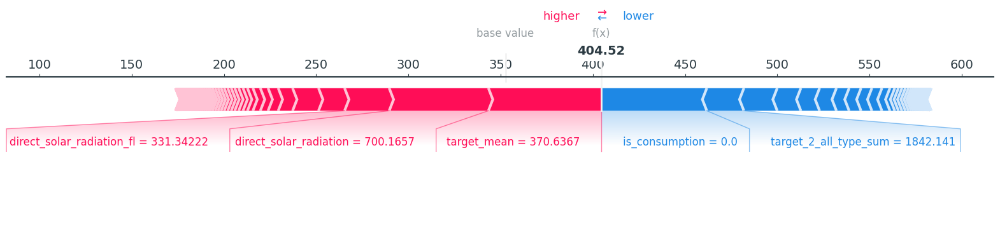

In [25]:
shap.plots.force(shap_values_lgbm[i_80], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_80.png")

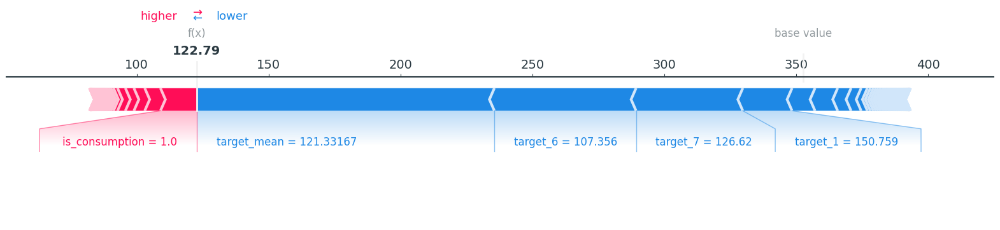

In [26]:
shap.plots.force(shap_values_lgbm[i_60], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_60.png")

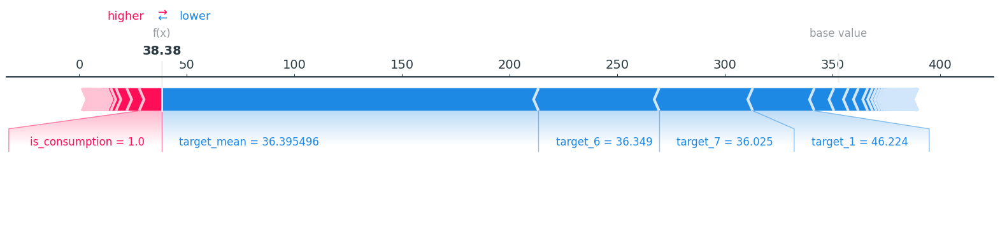

In [27]:
shap.plots.force(shap_values_lgbm[i_40], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_40.png")

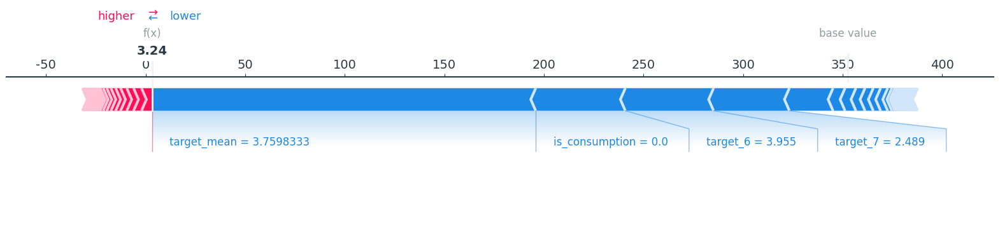

In [28]:
shap.plots.force(shap_values_lgbm[i_20], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_20.png")

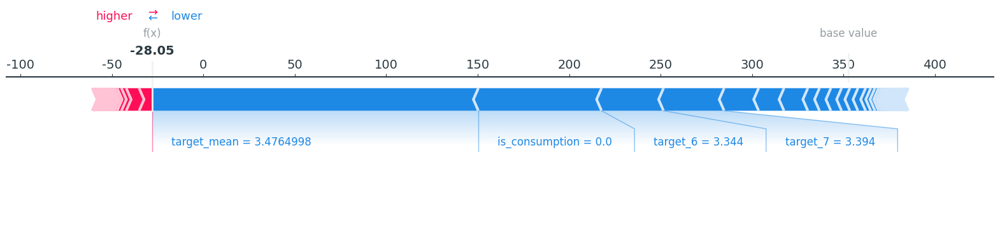

In [29]:
shap.plots.force(shap_values_lgbm[i_min], show=False, matplotlib=True)
plt.show()
# plt.savefig("plots/force_min.png")

In [30]:
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    mode='regression',
    feature_names=X_train.columns,
    class_names=['target'],
    verbose=True,
    discretize_continuous=True
)


In [31]:
j = i_min
exp = explainer.explain_instance(X_test.values[j], lgbm_model.predict, num_features=10)

Intercept 519.4052108032658
Prediction_local [-12.42338495]
Right: -28.051308371787027


In [32]:
exp.show_in_notebook(show_table=True)


In [33]:
exp.as_list()


[('1.24 < target_mean <= 37.05', -297.57627040580735),
 ('is_consumption <= 0.00', -115.65616772947789),
 ('0.76 < target_7 <= 32.64', -67.39274892895253),
 ('0.77 < target_1 <= 32.80', -61.680201416780676),
 ('installed_capacity <= 325.00', -51.28930396878611),
 ('winddirection_10m > 242.99', 49.24734301683307),
 ('0.77 < target_6 <= 32.76', -47.30497619697685),
 ('weekday <= 2.00', 40.953522559500264),
 ('temperature_fl_7d > 13.57', 34.49813073182608),
 ('year > 2022.00', -15.627923418215754)]

In [34]:
j = i_20
exp = explainer.explain_instance(X_test.values[j], lgbm_model.predict, num_features=10)

Intercept 538.8177959330089
Prediction_local [-15.04208169]
Right: 3.2445584876633053


In [35]:
exp.show_in_notebook(show_table=True)


In [36]:
exp.as_list()


[('1.24 < target_mean <= 37.05', -301.653094636001),
 ('is_consumption <= 0.00', -133.55187549327107),
 ('direct_solar_radiation_fl > 313.83', 79.74555029619346),
 ('0.77 < target_6 <= 32.76', -74.25291712490875),
 ('0.76 < target_7 <= 32.64', -67.98626516258011),
 ('0.77 < target_1 <= 32.80', -52.06380740384681),
 ('10.76 < surface_solar_radiation_downwards <= 228.75', -39.94122949592151),
 ('325.00 < installed_capacity <= 637.55', 34.996877012444216),
 ('1008.04 < surface_pressure_hl_7d <= 1014.20', 32.94531835716678),
 ('0.77 < target_5 <= 32.76', -32.09843397430696)]

In [37]:
j = i_40
exp = explainer.explain_instance(X_test.values[j], lgbm_model.predict, num_features=10)

Intercept 371.90866190107056
Prediction_local [97.98485442]
Right: 38.37594016947155


In [38]:
exp.show_in_notebook(show_table=True)


In [39]:
exp.as_list()


[('1.24 < target_mean <= 37.05', -287.7538168975474),
 ('0.50 < is_consumption <= 1.00', 151.90093345986713),
 ('32.76 < target_6 <= 168.34', -63.22556058190234),
 ('year > 2022.00', -59.60891424611709),
 ('32.64 < target_7 <= 167.03', -53.770771364836285),
 ('7.42 < temperature_fl <= 13.57', 38.81030881210295),
 ('0.85 < cloudcover_total_fl <= 1.00', 35.28736817975323),
 ('cloudcover_high_fl_7d > 0.87', -34.369654638824656),
 ('3.00 < month <= 6.00', -32.738922399967166),
 ('0.14 < cloudcover_mid_fl <= 0.71', 31.545222191989264)]

In [40]:
j = i_med
exp = explainer.explain_instance(X_test.values[j], lgbm_model.predict, num_features=10)

Intercept 388.30257733833673
Prediction_local [109.37102346]
Right: 74.09099664943754


In [41]:
exp.show_in_notebook(show_table=True)


In [42]:
exp.as_list()


[('1.24 < target_mean <= 37.05', -275.43160521848915),
 ('0.50 < is_consumption <= 1.00', 135.08000479160623),
 ('direct_solar_radiation_fl > 313.83', 81.94709313895129),
 ('0.77 < target_6 <= 32.76', -68.19880946907487),
 ('0.76 < target_7 <= 32.64', -47.59954224532527),
 ('windspeed_10m_hd_7d <= 3.26', 39.778797422642235),
 ('3.63 < target_6_all_type_sum <= 116.16', -37.302403802973714),
 ('weekday > 6.00', -36.86602332593013),
 ('year > 2022.00', -35.28002681340947),
 ('diffuse_radiation > 90.88', -35.05903835348751)]

In [43]:
j = i_60
exp = explainer.explain_instance(X_test.values[j], lgbm_model.predict, num_features=10)

Intercept 344.4265334526584
Prediction_local [219.02188288]
Right: 122.78548642495842


In [44]:
exp.show_in_notebook(show_table=True)


In [45]:
exp.as_list()


[('37.05 < target_mean <= 180.78', -208.07315707191637),
 ('0.50 < is_consumption <= 1.00', 131.627911789191),
 ('32.76 < target_6 <= 168.34', -80.7168659670122),
 ('32.64 < target_7 <= 167.03', -65.34423881677613),
 ('sin(hour) <= -0.71', 43.238574917393414),
 ('10_metre_u_wind_component_fl > 2.98', 42.54819571339883),
 ('installed_capacity > 1537.70', 42.35778460775739),
 ('cloudcover_total_hl_7d <= 22.67', 33.44715404864516),
 ('-2.33 < dewpoint_hl_2d <= 3.88', -33.14761226761101),
 ('0.00 < total_precipitation_fd_7d <= 0.00', -31.342397521089772)]

In [46]:
j = i_80
exp = explainer.explain_instance(X_test.values[j], lgbm_model.predict, num_features=10)

Intercept 68.99452360988505
Prediction_local [892.16290628]
Right: 404.5166460204095


In [47]:
exp.show_in_notebook(show_table=True)


In [48]:
exp.as_list()


[('target_mean > 180.78', 824.3040177651471),
 ('year > 2022.00', -487.646260260947),
 ('target_6 > 168.34', 198.04793363250343),
 ('target_7 > 167.03', 162.84881852135055),
 ('target_1 > 169.34', 137.99285081048183),
 ('is_consumption <= 0.00', -115.00128141546095),
 ('direct_solar_radiation_fl > 313.83', 63.30942061891924),
 ('direct_solar_radiation > 347.99', 41.861083150550506),
 ('cloudcover_low_hd_7d <= 9.25', -27.048333026482194),
 ('0.00 < cloudcover_low_fl <= 0.18', 24.500132875408095)]

In [49]:
j = i_max
exp = explainer.explain_instance(X_test.values[j], lgbm_model.predict, num_features=10)

Intercept -43.37513694237981
Prediction_local [5418.56219776]
Right: 9435.635441919529


In [50]:
exp.show_in_notebook(show_table=True)


In [51]:
exp.as_list()


[('year > 2022.00', 4017.0732441634377),
 ('target_mean > 180.78', 791.5753217887012),
 ('target_6 > 168.34', 184.1931475099705),
 ('target_7 > 167.03', 169.85396113115777),
 ('target_1 > 169.34', 146.46668570626412),
 ('0.50 < is_consumption <= 1.00', 117.19950944197325),
 ('installed_capacity > 1537.70', 44.43734727877174),
 ('total_precipitation_fl <= 0.00', 32.14445963194728),
 ('target_std > 45.16', -24.46552803506602),
 ('7.23 < direct_solar_radiation_hd_2d <= 108.06', -16.540813918693168)]

### Build Decision Tree and Improve in valid set

In [52]:
# dt_model = DecisionTreeRegressor(random_state=42, **best_params['dt_grid_search'].item())
# dt_model.fit(X_train, y_train)
# dump(dt_model, f'{save_dir}/dt_model_tuning.joblib')
dt_model=joblib.load(f'{save_dir}/dt_model_tuning.joblib')

In [53]:


dt_valid_predictions = dt_model.predict(X_valid)
dt_valid_mae = mean_absolute_error(y_valid, dt_valid_predictions)
dt_valid_r2 = r2_score(y_valid, dt_valid_predictions)
print(f"Decision Tree - Validation MAE: {dt_valid_mae:.3f}, Validation R2: {dt_valid_r2:.3f}")


Decision Tree - Validation MAE: 72.510, Validation R2: 0.934


In [54]:


dt_valid_predictions = dt_model.predict(X_test)
dt_valid_mae = mean_absolute_error(y_test, dt_valid_predictions)
dt_valid_r2 = r2_score(y_test, dt_valid_predictions)
print(f"Decision Tree - Test MAE: {dt_valid_mae:.3f}, Test R2: {dt_valid_r2:.3f}")


Decision Tree - Test MAE: 94.480, Test R2: 0.890


In [55]:
importances = dt_model.feature_importances_
indices = np.argsort(importances)[::-1]

In [56]:
print("Feature ranking:")
for i, index in enumerate(indices):
    print(f"{i + 1}. feature {X_train.columns[index]} ({importances[index]})")

Feature ranking:
1. feature target_mean (0.8309967959203889)
2. feature target_6 (0.10596979857282951)
3. feature target_6_all_type_sum (0.020143086885334012)
4. feature target_7 (0.01378633431281799)
5. feature target_7_all_type_sum (0.003147334432582601)
6. feature direct_solar_radiation_fl (0.002341788263313787)
7. feature surface_solar_radiation_downwards (0.0022823032551447433)
8. feature direct_solar_radiation (0.0018981343554530885)
9. feature surface_solar_radiation_downwards_fl (0.0018330347247371406)
10. feature is_consumption (0.0013387091811860236)
11. feature target_std (0.0013386644194552256)
12. feature installed_capacity (0.0010529453407650221)
13. feature weekday (0.0010500728976810582)
14. feature segment (0.0010228075233704842)
15. feature direct_solar_radiation_fd_7d (0.0007832531424107942)
16. feature row_id (0.0006825585421096897)
17. feature total_precipitation_fl (0.0006327193027602075)
18. feature cos(dayofyear) (0.0005482596825031994)
19. feature eic_count (0.

### Use LIME, SHAP to explained

In [57]:
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    mode='regression',  # Hoặc 'classification' nếu bạn làm việc với bài toán phân loại
    feature_names=X_train.columns,
    class_names=['target'],
    verbose=True,
    discretize_continuous=True
)


In [58]:
i_med = np.argsort(dt_valid_predictions)[len(dt_valid_predictions)//2]
i_max = np.argmax(dt_valid_predictions)
i_80 = np.argsort(dt_valid_predictions)[int(len(dt_valid_predictions)*0.8)]
i_60 = np.argsort(dt_valid_predictions)[int(len(dt_valid_predictions)*0.6)]
i_40 = np.argsort(dt_valid_predictions)[int(len(dt_valid_predictions)*0.4)]
i_20 = np.argsort(dt_valid_predictions)[int(len(dt_valid_predictions)*0.2)]
i_min = np.argmin(dt_valid_predictions)

In [59]:
j = i_min
exp = explainer.explain_instance(X_test.values[j], dt_model.predict, num_features=10)

Intercept 555.2147769712035
Prediction_local [-8.0541786]
Right: 0.09521932311399434


In [60]:
exp.show_in_notebook(show_table=True)


In [61]:
exp.as_list()


[('target_mean <= 1.24', -493.21511542654184),
 ('target_ratio <= 0.45', 65.48042576515418),
 ('3.78 < windspeed_10m_hl_2d <= 5.14', -63.169314953437194),
 ('-2.33 < dewpoint_hl_2d <= 3.88', -62.878988127651),
 ('0.73 < 10_metre_v_wind_component_fl <= 2.55', 60.36287555439557),
 ('diffuse_radiation_hd_7d <= 1.13', -59.89645843520699),
 ('snowfall_hl_2d <= 0.00', -58.806173841419266),
 ('segment <= 34.00', 53.00446370615543),
 ('windspeed_10m_hl_7d <= 2.64', -52.996980876054664),
 ('-1.75 < dewpoint_hd_2d <= 4.25', 48.846311062146334)]

In [62]:
j = i_20
exp = explainer.explain_instance(X_test.values[j], dt_model.predict, num_features=6)

Intercept 510.8064974369753
Prediction_local [-23.61739858]
Right: 10.335549098920207


In [63]:
exp.show_in_notebook(show_table=True)


In [64]:
exp.as_list()


[('1.24 < target_mean <= 37.05', -463.15367093214354),
 ('shortwave_radiation_hd_7d > 209.38', -70.39896580200278),
 ('temperature_hl_2d > 13.60', 67.50806211823723),
 ('637.55 < installed_capacity <= 1537.70', -63.573545363142195),
 ('direct_solar_radiation_hl_7d > 88.33', -57.74789565185176),
 ('rain > 0.05', 52.94211961099694)]

In [65]:
j = i_40
exp = explainer.explain_instance(X_test.values[j], dt_model.predict, num_features=6)

Intercept 463.99755926244364
Prediction_local [70.38969489]
Right: 33.245104262101705


In [66]:
exp.show_in_notebook(show_table=True)


In [67]:
exp.as_list()


[('1.24 < target_mean <= 37.05', -450.5617252476349),
 ('surface_pressure_hl_7d > 1014.20', 64.17307208393778),
 ('total_precipitation_fd_7d <= 0.00', -57.08578499197352),
 ('0.66 < target_std <= 7.74', 52.50138073766311),
 ('7.38 < direct_solar_radiation_hd_7d <= 108.15', -49.26014675100214),
 ('0.09 < sin(dayofyear) <= 0.73', 46.62533979781106)]

In [68]:
j = i_med
exp = explainer.explain_instance(X_test.values[j], dt_model.predict, num_features=6)


Intercept 452.5405240324822
Prediction_local [86.57502219]
Right: 68.31701431492837


In [69]:
exp.show_in_notebook(show_table=True)


In [70]:
exp.as_list()


[('37.05 < target_mean <= 180.78', -344.1746509493623),
 ('cloudcover_low_fl_7d <= 0.00', 83.20369051835762),
 ('3.93 < dewpoint_fl_7d <= 9.48', 66.54853056089586),
 ('shortwave_radiation_hd_7d > 209.38', -60.48831205986989),
 ('cloudcover_low_fd_7d <= 0.06', -58.04980447492934),
 ('direct_solar_radiation_hl_2d > 88.25', -53.00495544170503)]

In [71]:
j = i_60
exp = explainer.explain_instance(X_test.values[j], dt_model.predict, num_features=6)


Intercept 484.64273976478324
Prediction_local [86.09999049]
Right: 132.4158895705525


In [72]:
exp.show_in_notebook(show_table=True)


In [73]:
exp.as_list()


[('37.05 < target_mean <= 180.78', -372.5820871273798),
 ('3.00 < month <= 6.00', 67.79156090760888),
 ('0.00 < cloudcover_high_fl <= 0.13', 61.68591136964114),
 ('windspeed_10m_hl_2d > 5.14', -56.76081128046273),
 ('surface_pressure > 1015.96', -53.41558976835775),
 ('0.25 < cloudcover_total_fl <= 0.85', -45.261733372500466)]

In [74]:
j = i_80
exp = explainer.explain_instance(X_test.values[j], dt_model.predict, num_features=6)


Intercept 37.57024204958128
Prediction_local [890.9264563]
Right: 421.587376470588


In [75]:
exp.show_in_notebook(show_table=True)


In [76]:
exp.as_list()


[('target_mean > 180.78', 1267.5514293523229),
 ('year > 2022.00', -469.33907982896545),
 ('target_7 > 167.03', 79.80327513931871),
 ('target_6 > 168.34', 67.2039666400898),
 ('637.55 < installed_capacity <= 1537.70', -53.662969975063746),
 ('is_consumption <= 0.00', -38.20040707773117)]

In [77]:
j = i_max
exp = explainer.explain_instance(X_test.values[j], dt_model.predict, num_features=6)


Intercept 22.084071085946107
Prediction_local [5962.60906529]
Right: 10501.524833333335


In [78]:
exp.show_in_notebook(show_table=True)


In [79]:
exp.as_list()


[('year > 2022.00', 4538.915768038883),
 ('target_mean > 180.78', 1274.3765742809717),
 ('0.24 < cloudcover_mid_fd_7d <= 0.53', 62.45601079937362),
 ('target_6 > 168.34', 54.36258410885447),
 ('10_metre_u_wind_component_fd_7d <= -1.10', 49.65932799945159),
 ('is_consumption <= 0.00', -39.245271019032046)]

In [80]:
xgboost_model=joblib.load(f'{save_dir}/dt_model_tuning.joblib')

In [81]:
xgboost_model_predictions = xgboost_model.predict(X_valid)
xgboost_model_mae = mean_absolute_error(y_valid, xgboost_model_predictions)
xgboost_model_r2 = r2_score(y_valid, xgboost_model_predictions)
print(f"XGboost model - Validation MAE: {xgboost_model_mae:.3f}, Validation R2: {xgboost_model_r2:.3f}")

XGboost model - Validation MAE: 72.510, Validation R2: 0.934


In [82]:
xgboost_model_predictions = xgboost_model.predict(X_test)
xgboost_model_mae = mean_absolute_error(y_test, xgboost_model_predictions)
xgboost_model_r2 = r2_score(y_test, xgboost_model_predictions)
print(f"XGboost model - Validation MAE: {xgboost_model_mae:.3f}, Validation R2: {xgboost_model_r2:.3f}")

XGboost model - Validation MAE: 94.480, Validation R2: 0.890


In [83]:
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train.values,
    mode='regression',
    feature_names=X_train.columns,
    class_names=['target'],
    verbose=True,
    discretize_continuous=True
)


In [84]:
i_med = np.argsort(xgboost_model_predictions)[len(xgboost_model_predictions)//2]
i_max = np.argmax(xgboost_model_predictions)
i_80 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.8)]
i_60 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.6)]
i_40 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.4)]
i_20 = np.argsort(xgboost_model_predictions)[int(len(xgboost_model_predictions)*0.2)]
i_min = np.argmin(xgboost_model_predictions)


In [85]:
j = i_min
exp = explainer.explain_instance(X_test.values[j], xgboost_model.predict, num_features=10)

Intercept 465.73771321292344
Prediction_local [36.67032232]
Right: 0.09521932311399434


In [86]:
exp.show_in_notebook(show_table=True)


In [87]:
exp.as_list()


[('target_mean <= 1.24', -483.2320233939236),
 ('4.26 < dewpoint_hd_7d <= 9.64', 72.1981196253287),
 ('rain_hl_2d <= 0.00', -63.221159630313174),
 ('7.60 < temperature_hl_7d <= 13.60', -52.91461371419463),
 ('surface_solar_radiation_downwards_fd_7d <= 0.00', 47.47671624302937),
 ('-1.16 < 10_metre_u_wind_component_fl <= 1.25', -47.34190994203561),
 ('0.82 < 10_metre_v_wind_component <= 2.95', 46.088857030979455),
 ('row_id > 1195771.75', 44.267768080372235),
 ('snowfall_hl_2d <= 0.00', 44.18595780573653),
 ('year > 2022.00', -36.57510299739519)]

In [88]:
j = i_20
exp = explainer.explain_instance(X_test.values[j], xgboost_model.predict, num_features=10)

Intercept 406.842571148445
Prediction_local [42.96578935]
Right: 10.335549098920207


In [89]:
exp.show_in_notebook(show_table=True)


In [90]:
exp.as_list()


[('1.24 < target_mean <= 37.05', -429.52997757969587),
 ('snowfall_hl_2d <= 0.00', 58.23252039761723),
 ('0.76 < target_7 <= 32.64', -54.66791826960594),
 ('windspeed_10m > 5.67', 53.41518616735221),
 ('10_metre_v_wind_component_fl > 2.55', 51.321899864017915),
 ('direct_solar_radiation_fl > 313.83', 46.10565352312476),
 ('0.00 < cloudcover_low_fl_7d <= 0.18', -44.05214410197186),
 ('direct_solar_radiation_hd_7d > 108.15', -43.537365503356824),
 ('temperature_fl_7d > 13.57', -39.69447186794382),
 ('euros_per_mwh <= 104.18', 38.52983556777195)]

In [91]:
j = i_40
exp = explainer.explain_instance(X_test.values[j], xgboost_model.predict, num_features=6)

Intercept 605.6168234553631
Prediction_local [-115.60772512]
Right: 33.245104262101705


In [92]:
exp.show_in_notebook(show_table=True)


In [93]:
exp.as_list()


[('1.24 < target_mean <= 37.05', -455.4628805778419),
 ('snowfall_hd_2d <= 0.00', -59.58883933617032),
 ('snowfall_fd_7d <= 0.00', -59.15430510776752),
 ('3.25 < windspeed_10m <= 4.37', -50.786949387886295),
 ('32.76 < target_5 <= 168.57', -49.25612177722431),
 ('hours_ahead_fl <= 31.00', -46.97545238652195)]

In [94]:
j = i_med
exp = explainer.explain_instance(X_test.values[j], xgboost_model.predict, num_features=6)


Intercept 459.02961845818356
Prediction_local [49.94669706]
Right: 68.31701431492837


In [95]:
exp.show_in_notebook(show_table=True)


In [96]:
exp.as_list()


[('37.05 < target_mean <= 180.78', -346.17119071810504),
 ('34.00 < segment <= 69.00', -60.30007324722412),
 ('cloudcover_low_fl_7d <= 0.00', -55.38270306854513),
 ('cloudcover_total_hl_2d <= 22.67', 51.90811442582569),
 ('cloudcover_mid <= 0.06', 51.652028247088126),
 ('direct_solar_radiation_fl_7d > 314.82', -50.78909703880692)]

In [97]:
j = i_60
exp = explainer.explain_instance(X_test.values[j], xgboost_model.predict, num_features=6)


Intercept 555.034263884369
Prediction_local [-0.9358416]
Right: 132.4158895705525


In [98]:
exp.show_in_notebook(show_table=True)


In [99]:
exp.as_list()


[('37.05 < target_mean <= 180.78', -380.2784626065758),
 ('0.00 < cloudcover_high_fl <= 0.13', -69.39700015638299),
 ('0.30 < cloudcover_high_fd_7d <= 0.62', -66.62678500653601),
 ('32.80 < target_1 <= 169.34', 56.64748692323316),
 ('snowfall_fd_7d <= 0.00', -49.49151137771542),
 ('product_type <= 1.00', -46.8238332651731)]

In [100]:
j = i_80
exp = explainer.explain_instance(X_test.values[j], xgboost_model.predict, num_features=6)


Intercept 74.67744766819055
Prediction_local [1305.99842811]
Right: 421.587376470588


In [101]:
exp.show_in_notebook(show_table=True)


In [102]:
exp.as_list()


[('target_mean > 180.78', 1274.5284393584732),
 ('637.55 < installed_capacity <= 1537.70', -55.91134071779422),
 ('target_6 > 168.34', 55.44246105259151),
 ('direct_solar_radiation > 347.99', 53.4307655979892),
 ('0.07 < cloudcover_high <= 0.30', -48.90467290804569),
 ('snowfall_fd_7d <= 0.00', -47.26467194507788)]

In [103]:
j = i_max
exp = explainer.explain_instance(X_test.values[j], xgboost_model.predict, num_features=6)


Intercept 63.44591789476664
Prediction_local [5913.41696283]
Right: 10501.524833333335


In [104]:
exp.show_in_notebook(show_table=True)


In [105]:
exp.as_list()


[('year > 2022.00', 4588.107870504707),
 ('target_mean > 180.78', 1301.4876256007499),
 ('target_7 > 167.03', 83.35957666061492),
 ('0.25 < cloudcover_mid <= 0.54', -44.83129917586388),
 ('is_consumption <= 0.00', -39.75265024725176),
 ('direct_solar_radiation_fl_7d > 314.82', -38.4000784091302)]